# Spotify Music Recommendation App

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 

import warnings
warnings.filterwarnings("ignore")


from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

In [2]:
data = pd.read_csv("data.csv")

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
data.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653.000000,1.706530e+05,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000
mean,0.528587,1976.787241,0.502115,0.537396,2.309483e+05,0.482389,0.084575,0.167010,5.199844,0.205839,-11.467990,0.706902,31.431794,0.098393,116.861590
std,0.263171,25.917853,0.376032,0.176138,1.261184e+05,0.267646,0.278249,0.313475,3.515094,0.174805,5.697943,0.455184,21.826615,0.162740,30.708533
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.615000,0.000000,11.000000,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.580000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624000e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


In [5]:
data.columns

Index(['valence', 'year', 'acousticness', 'artists', 'danceability',
       'duration_ms', 'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date',
       'speechiness', 'tempo'],
      dtype='object')

In [6]:
data = data.reindex(columns =  ['name', 'year', 'artists', 'duration_ms', 'popularity', 'valence', 'acousticness',  'danceability',
       'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode',  'release_date',
       'speechiness', 'tempo'])

In [7]:
data.head()

,name,year,artists,duration_ms,popularity,valence,acousticness,danceability,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,release_date,speechiness,tempo
0,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",1921,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",831667,4,0.0594,0.982,0.279,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,1921,0.0366,80.954
1,Clancy Lowered the Boom,1921,['Dennis Day'],180533,5,0.9630,0.732,0.819,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,1921,0.4150,60.936
2,Gati Bali,1921,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,500062,5,0.0394,0.961,0.328,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,1921,0.0339,110.339
3,Danny Boy,1921,['Frank Parker'],210000,3,0.1650,0.967,0.275,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,1921,0.0354,100.109
4,When Irish Eyes Are Smiling,1921,['Phil Regan'],166693,2,0.2530,0.957,0.418,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,1921,0.0380,101.665


In [8]:
data = data.drop(['release_date','id','key','mode','explicit'], axis=1)

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   name              170653 non-null  object 
 1   year              170653 non-null  int64  
 2   artists           170653 non-null  object 
 3   duration_ms       170653 non-null  int64  
 4   popularity        170653 non-null  int64  
 5   valence           170653 non-null  float64
 6   acousticness      170653 non-null  float64
 7   danceability      170653 non-null  float64
 8   energy            170653 non-null  float64
 9   instrumentalness  170653 non-null  float64
 10  liveness          170653 non-null  float64
 11  loudness          170653 non-null  float64
 12  speechiness       170653 non-null  float64
 13  tempo             170653 non-null  float64
dtypes: float64(9), int64(3), object(2)
memory usage: 18.2+ MB


In [10]:
data.head(5)

,name,year,artists,duration_ms,popularity,valence,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo
0,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",1921,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",831667,4,0.0594,0.982,0.279,0.211,0.878000,0.665,-20.096,0.0366,80.954
1,Clancy Lowered the Boom,1921,['Dennis Day'],180533,5,0.9630,0.732,0.819,0.341,0.000000,0.160,-12.441,0.4150,60.936
2,Gati Bali,1921,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,500062,5,0.0394,0.961,0.328,0.166,0.913000,0.101,-14.850,0.0339,110.339
3,Danny Boy,1921,['Frank Parker'],210000,3,0.1650,0.967,0.275,0.309,0.000028,0.381,-9.316,0.0354,100.109
4,When Irish Eyes Are Smiling,1921,['Phil Regan'],166693,2,0.2530,0.957,0.418,0.193,0.000002,0.229,-10.096,0.0380,101.665


In [11]:
# Converting music duration from milliseconds to minutes

data['duration_ms'] = (data['duration_ms']/(1000*60))%60 

In [12]:
data.head()

,name,year,artists,duration_ms,popularity,valence,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo
0,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",1921,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",13.861117,4,0.0594,0.982,0.279,0.211,0.878000,0.665,-20.096,0.0366,80.954
1,Clancy Lowered the Boom,1921,['Dennis Day'],3.008883,5,0.9630,0.732,0.819,0.341,0.000000,0.160,-12.441,0.4150,60.936
2,Gati Bali,1921,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,8.334367,5,0.0394,0.961,0.328,0.166,0.913000,0.101,-14.850,0.0339,110.339
3,Danny Boy,1921,['Frank Parker'],3.500000,3,0.1650,0.967,0.275,0.309,0.000028,0.381,-9.316,0.0354,100.109
4,When Irish Eyes Are Smiling,1921,['Phil Regan'],2.778217,2,0.2530,0.957,0.418,0.193,0.000002,0.229,-10.096,0.0380,101.665


In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   name              170653 non-null  object 
 1   year              170653 non-null  int64  
 2   artists           170653 non-null  object 
 3   duration_ms       170653 non-null  float64
 4   popularity        170653 non-null  int64  
 5   valence           170653 non-null  float64
 6   acousticness      170653 non-null  float64
 7   danceability      170653 non-null  float64
 8   energy            170653 non-null  float64
 9   instrumentalness  170653 non-null  float64
 10  liveness          170653 non-null  float64
 11  loudness          170653 non-null  float64
 12  speechiness       170653 non-null  float64
 13  tempo             170653 non-null  float64
dtypes: float64(10), int64(2), object(2)
memory usage: 18.2+ MB


In [14]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}'.format(period_start)
    return decade

decade = data['year'].apply(get_decade)

In [15]:
decade.value_counts()

1970    20000
1990    19901
1950    19850
1980    19850
2010    19774
2000    19646
1960    19549
1940    15378
1930     9549
1920     5126
2020     2030
Name: year, dtype: int64

In [16]:
data.shape

(170653, 14)

In [17]:
# Dropping data from the year 1920 to 1949 as it might skew the results

data.drop(data[data.year <= 1949].index, inplace=True)

In [18]:
data.shape

(140600, 14)

In [19]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}'.format(period_start)
    return decade

decade = data['year'].apply(get_decade)
decade.value_counts()

1970    20000
1990    19901
1950    19850
1980    19850
2010    19774
2000    19646
1960    19549
2020     2030
Name: year, dtype: int64

In [20]:
data.head(5)

,name,year,artists,duration_ms,popularity,valence,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo
5606,Someone To Watch Over Me,1950,['Ella Fitzgerald'],3.277783,56,0.197,0.990,0.354,0.0851,0.000004,0.1230,-13.738,0.0345,97.684
5607,I've Got A Crush On You,1950,['Ella Fitzgerald'],3.274000,55,0.258,0.986,0.455,0.1060,0.000000,0.1220,-14.086,0.0422,66.807
5608,Stardust,1950,['Hoagy Carmichael'],2.439117,42,0.345,0.960,0.658,0.0542,0.106000,0.1060,-19.427,0.0596,90.138
5609,If You've Got the Money I've Got the Time,1950,['Lefty Frizzell'],2.988450,43,0.951,0.830,0.545,0.3920,0.000094,0.0903,-10.091,0.0481,208.426
5610,Powder Your Face With Sunshine (Smile! Smile! ...,1950,"['Dean Martin', 'Paul Weston And His Orchestra']",2.585117,37,0.540,0.958,0.498,0.2210,0.053000,0.2220,-11.750,0.0450,168.748


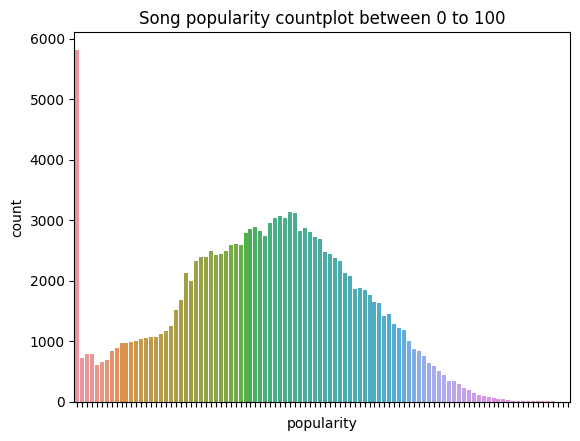

In [21]:
sns.countplot(data=data, x='popularity').set(xticklabels=[])
plt.title("Song popularity countplot between 0 to 100")
plt.show()

In [22]:
# Dropping values with popularity = 0
data.drop(data[data.popularity == 0].index, inplace=True)

<AxesSubplot: >

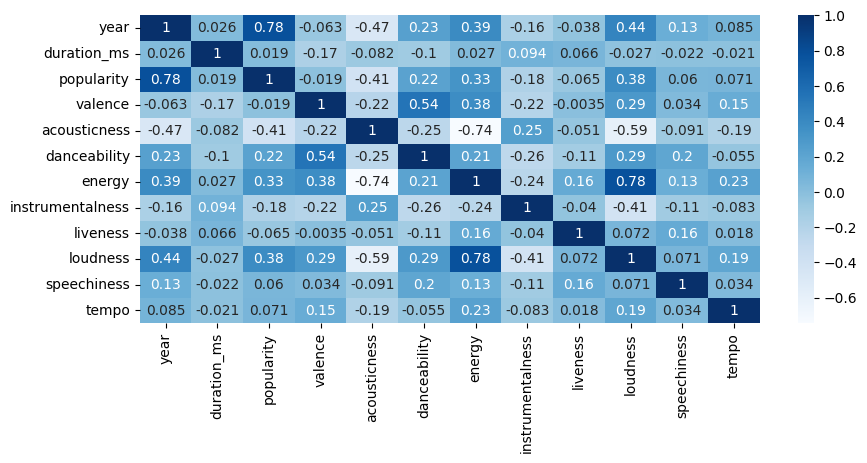

In [23]:
corr = data.corr()
plt.figure(figsize=(10,4))
sns.heatmap(corr,annot=True,cmap='Blues')

In [24]:
# Dropping duration, speechiness and tempo columns from the dataset as they have almost no-correlation with other variables

data = data.drop(['duration_ms', 'speechiness', 'tempo'], axis=1)

<AxesSubplot: >

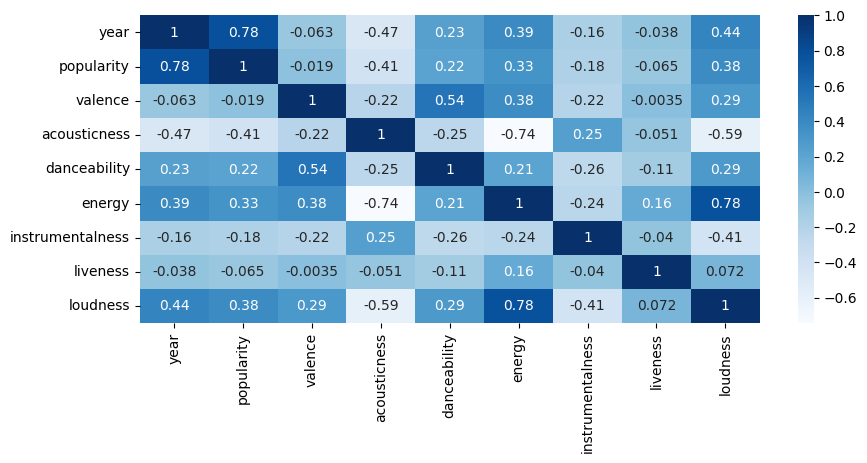

In [25]:
corr = data.corr()
plt.figure(figsize=(10,4))
sns.heatmap(corr,annot=True,cmap='Blues')

<AxesSubplot: xlabel='loudness'>

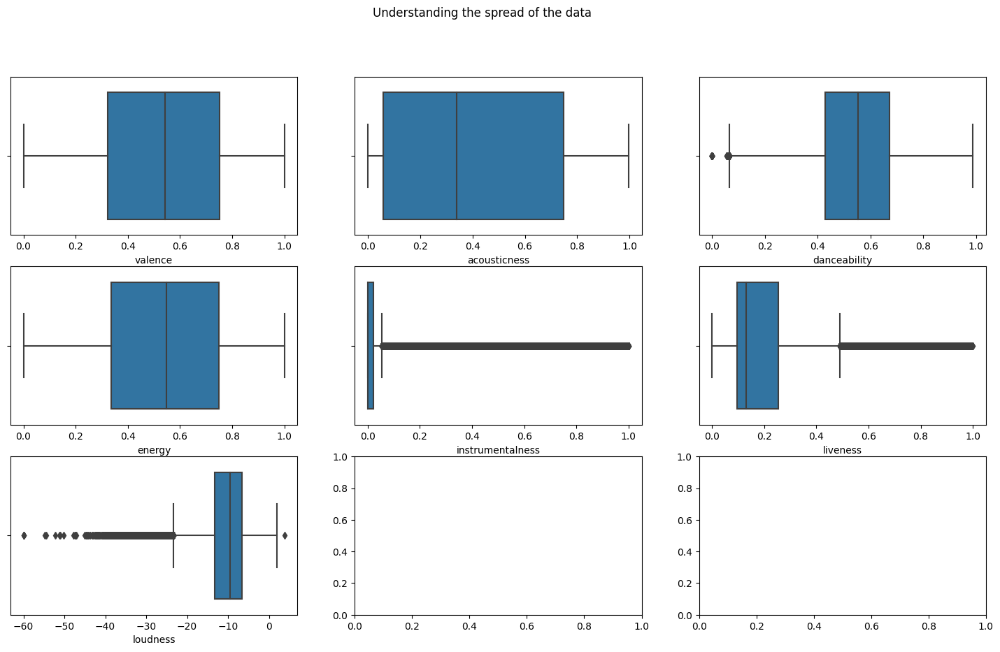

In [26]:
fig, axes = plt.subplots(3, 3, figsize=(18, 10))

fig.suptitle('Understanding the spread of the data')

sns.boxplot(ax=axes[0, 0], data=data, x='valence')
sns.boxplot(ax=axes[0, 1], data=data, x='acousticness')
sns.boxplot(ax=axes[0, 2], data=data, x='danceability')
sns.boxplot(ax=axes[1, 0], data=data, x='energy')
sns.boxplot(ax=axes[1, 1], data=data, x='instrumentalness')
sns.boxplot(ax=axes[1, 2], data=data, x='liveness')
sns.boxplot(ax=axes[2, 0], data=data, x='loudness')

In [27]:
data.columns

Index(['name', 'year', 'artists', 'popularity', 'valence', 'acousticness',
       'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness'],
      dtype='object')

In [28]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 134783 entries, 5606 to 170652
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   name              134783 non-null  object 
 1   year              134783 non-null  int64  
 2   artists           134783 non-null  object 
 3   popularity        134783 non-null  int64  
 4   valence           134783 non-null  float64
 5   acousticness      134783 non-null  float64
 6   danceability      134783 non-null  float64
 7   energy            134783 non-null  float64
 8   instrumentalness  134783 non-null  float64
 9   liveness          134783 non-null  float64
 10  loudness          134783 non-null  float64
dtypes: float64(7), int64(2), object(2)
memory usage: 12.3+ MB


<AxesSubplot: xlabel='loudness', ylabel='Density'>

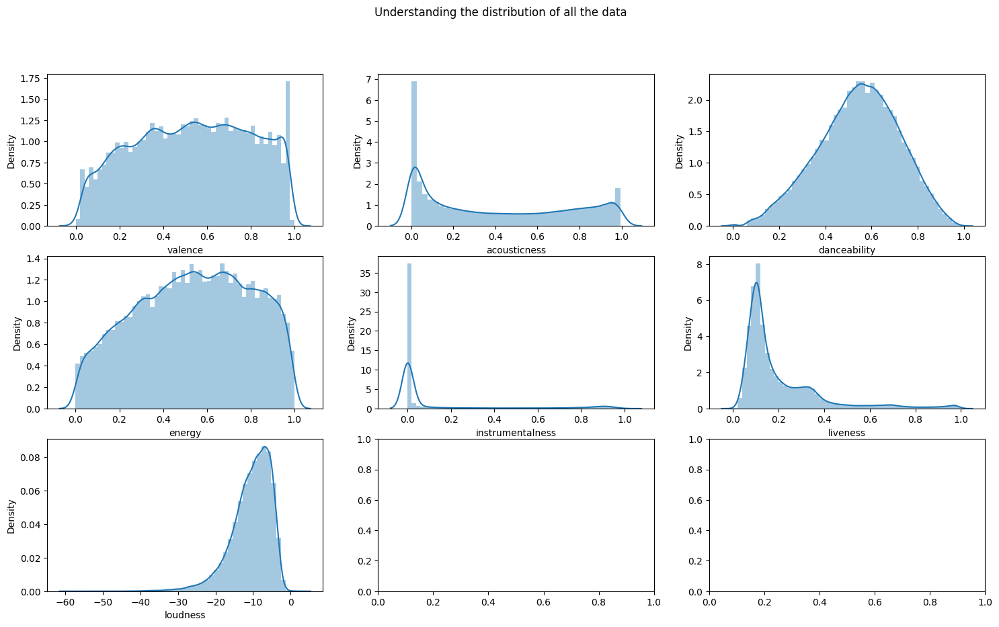

In [29]:
fig, axes = plt.subplots(3, 3, figsize=(18, 10))

fig.suptitle('Understanding the distribution of all the data')
sns.distplot(data['valence'],kde = True, ax=axes[0, 0])
sns.distplot(data['acousticness'],kde = True, ax=axes[0, 1])
sns.distplot(data['danceability'],kde = True, ax=axes[0, 2])
sns.distplot(data['energy'],kde = True, ax=axes[1, 0])
sns.distplot(data['instrumentalness'],kde = True, ax=axes[1, 1])
sns.distplot(data['liveness'],kde = True, ax=axes[1, 2])
sns.distplot(data['loudness'],kde = True, ax=axes[2, 0])

<p><b>Valence</b>: The data is not skewed but the normal distribution looks more like a binomial distribution</p>


In [30]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [31]:
data.head(10)

,name,year,artists,popularity,valence,acousticness,danceability,energy,instrumentalness,liveness,loudness,cluster_label
5606,Someone To Watch Over Me,1950,['Ella Fitzgerald'],56,0.197,0.990,0.354,0.0851,0.000004,0.1230,-13.738,19
5607,I've Got A Crush On You,1950,['Ella Fitzgerald'],55,0.258,0.986,0.455,0.1060,0.000000,0.1220,-14.086,19
5608,Stardust,1950,['Hoagy Carmichael'],42,0.345,0.960,0.658,0.0542,0.106000,0.1060,-19.427,8
5609,If You've Got the Money I've Got the Time,1950,['Lefty Frizzell'],43,0.951,0.830,0.545,0.3920,0.000094,0.0903,-10.091,6
5610,Powder Your Face With Sunshine (Smile! Smile! ...,1950,"['Dean Martin', 'Paul Weston And His Orchestra']",37,0.540,0.958,0.498,0.2210,0.053000,0.2220,-11.750,8
5611,Night on Bald Mountain,1950,"['Modest Mussorgsky', 'Leonard Bernstein', 'Ne...",32,0.095,0.854,0.316,0.3080,0.888000,0.5850,-15.944,12
5612,The Yellow Rose of Texas - Single Version,1950,['Mitch Miller'],36,0.929,0.835,0.788,0.8780,0.000009,0.0892,-8.834,6
5613,Always Late (With Your Kisses),1950,['Lefty Frizzell'],31,0.567,0.842,0.776,0.1980,0.000000,0.3500,-11.406,8
5614,El Nido,1950,['La Sonora Santanera'],28,0.964,0.779,0.598,0.4280,0.000006,0.0625,-10.487,6
5615,A la Luz del Día,1950,['Gerardo Reyes'],32,0.576,0.724,0.538,0.2870,0.000001,0.2820,-11.029,8


In [36]:
data.shape

(134783, 12)

In [32]:
data.drop(data[data.name.astype(str).str.startswith('%')].index, inplace=True)

In [37]:
data.shape

(134783, 12)

In [33]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [34]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'energy', 
 'instrumentalness', 'liveness', 'loudness', 'popularity']


def get_song_data(song, data):
    
    try:
        song_data = data[(data['name'] == song['name']) 
                                & (data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return "Not Found"
        

def get_mean_vector(song_list, data):
    
    song_vectors = []
    
    for song in song_list:
        data = get_song_data(song, data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [35]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  data)

NameError: name 'song_data' is not defined